In [111]:
!pip install open3d

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [112]:
from google.colab import drive
drive.mount('/content/drive') 

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [113]:
# from google.colab import drive
# drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [114]:
import numpy as np
import glob
import cv2
import open3d as o3d

In [115]:
# images = sorted(glob.glob('./CV-A2-calibration/camera_images/*.jpeg'))
images = sorted(glob.glob('/content/drive/MyDrive/CV_Assi2/calibration/camera_images/*.jpeg')) 

In [116]:
chessboard= (8, 6)
chessboardsize = 0.108

In [117]:
import os

`Getting lidar normals and offsets for each lidar camera pair`

In [118]:
K = np.loadtxt('/content/drive/MyDrive/CV_Assi2/calibration/camera_parameters/camera_intrinsic.txt')
dist = np.loadtxt('/content/drive/MyDrive/CV_Assi2/calibration/camera_parameters/distortion.txt')
lidar_point_clouds = [] 


lidar_points=[]
lidar_normal_offset = [[],[]] 
camera_normal_offset = [[],[]] 
rvecs=[]
tvecs=[]
R_matrix=[]
imgpoints = []

camera_parameters_path = '/content/drive/MyDrive/CV_Assi2/calibration/camera_parameters'
camera_images_path = '/content/drive/MyDrive/CV_Assi2/calibration/camera_images'

counter =0
for subdir, dir, files in os.walk(camera_parameters_path): 
    # print(dir)  
    # print(i+1)
    for d in dir:

        if(counter == 25):
          break
        counter = counter + 1
        
        # print(d[:-5]) 

        img_name = d[:-5] 
        img = cv2.imread(camera_images_path + '/'+ str(d) )

        # print(image[58:]) 
        folderpath = ('/content/drive/MyDrive/CV_Assi2/calibration/camera_parameters/' + d) 
        # print(folderpath+'\camera_normals.txt')
        #/content/drive/MyDrive/CV_Assi2/calibration/camera_parameters/frame_1061.jpeg/camera_normals.txt
        nc = np.loadtxt(folderpath+'/camera_normals.txt')

        camera_normal_offset[0].append(nc)
        
        R_matrix.append(np.loadtxt(folderpath+'/rotation_matrix.txt'))
        rvecs.append(np.loadtxt(folderpath+'/rotation_vectors.txt'))
        
        tvecs.append(np.loadtxt(folderpath+'/translation_vectors.txt'))
        tvec = np.loadtxt(folderpath+'/translation_vectors.txt') 
        camera_normal_offset[1].append(-np.dot(nc, tvec))

        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        retval, corners = cv2.findChessboardCorners(gray, chessboard, None)
        if retval:
            win_size = (11,11)
            zero_z = (-1,-1)
            criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
            corners= cv2.cornerSubPix(gray,corners, win_size , zero_z , criteria ) 
            imgpoints.append(corners)

        # print('\content\drive\MyDrive\CV_Assi2\calibration\lidar_scans\\'+img_name+'pcd') 
        lidar_pc = o3d.io.read_point_cloud('/content/drive/MyDrive/CV_Assi2/calibration/lidar_scans//'+img_name+'.pcd') 
        lidar_point_clouds.append(lidar_pc)
        
        points = np.asarray(lidar_pc.points)
        lidar_points.append(np.asarray(lidar_pc.points)) 
        
        points_centered = points - np.mean(points, axis=0)
        U, S, Vt = np.linalg.svd(points_centered)
        
        lidar_normal_offset[0].append(Vt[2, :])
        # lidarnormals.append(Vt[2, :]) 
        centroid = np.mean(points, axis=0)
        
        nl = Vt[2, :]
        dot_product =np.dot(nl.T, tvec) 
        dl = -dot_product
        # dl = -np.dot(nl, centroid) 
        lidar_normal_offset[1].append(dl) 
        print("Lidar normal",nl)
        print("Lidar offset", dl) 

# print(camera_normals) 

Lidar normal [-0.73737765  0.5739658   0.35614247]
Lidar offset -0.6173963843995338
Lidar normal [-0.43460444  0.89601842 -0.09093933]
Lidar offset 1.6581593500032712
Lidar normal [-0.76477664  0.64422625  0.00944619]
Lidar offset 2.440154424620167
Lidar normal [0.94902101 0.13112718 0.28664401]
Lidar offset -0.5166637933458826
Lidar normal [ 0.98745566  0.06712949 -0.14291586]
Lidar offset 4.485033369802012
Lidar normal [-0.61872738  0.78293781 -0.06469016]
Lidar offset 2.59786331743304
Lidar normal [-0.97607976  0.21597961 -0.02492227]
Lidar offset 0.12024157412940559
Lidar normal [-0.9493562  -0.22833398  0.21583881]
Lidar offset -0.2863429655511951
Lidar normal [ 0.95936444 -0.00899235 -0.2820266 ]
Lidar offset 1.1827325017995012
Lidar normal [ 0.60371533 -0.79239849  0.08736381]
Lidar offset -0.27591558972753
Lidar normal [-0.95207118  0.1539658  -0.26430097]
Lidar offset 1.503227211795524
Lidar normal [ 0.75932657 -0.56254883  0.32705042]
Lidar offset -3.0119529682117365
Lidar no

In [120]:
# print(cameranormals)
# print(cameraoffset)

[[-0.43432021 -0.35965743 -0.82584047]
 [-0.81629617  0.09162133 -0.57032105]
 [-0.45613391 -0.00554963 -0.88989385]
 [ 0.29001348  0.28627248 -0.91320329]
 [ 0.27176261 -0.16526395 -0.94806799]
 [-0.65671387  0.05477644 -0.75214788]
 [-0.03246712 -0.00217473 -0.99947044]
 [ 0.39126525 -0.23402562 -0.89002445]
 [ 0.16303408 -0.29304993 -0.94209428]
 [-0.70422432  0.07305109 -0.70620935]
 [ 0.00739864  0.25390736 -0.96720024]
 [-0.42402941  0.31924201 -0.84751613]
 [-0.73875133 -0.10276552 -0.66609738]
 [-0.06913268  0.23786099 -0.96883581]
 [-0.65477401  0.164822   -0.73763454]
 [-0.13917323 -0.2935912  -0.94574575]
 [-0.795691    0.24197359 -0.55526986]
 [-0.24936746  0.22474881 -0.94196807]
 [-0.68682933 -0.43663579 -0.58104618]
 [-0.06925356 -0.07564818 -0.99472675]
 [-0.18954575  0.13129915 -0.97305341]
 [-0.05275962  0.22970552 -0.9718291 ]
 [-0.55917687 -0.07439273 -0.82570391]
 [ 0.34835151  0.25517693 -0.90196228]
 [ 0.65789388 -0.28542777 -0.69692656]]
[[3.47754136]
 [6.252637

`Getting the camera and lidar normals, offsets in 2-D array like form`

In [121]:
camera_normal_offset[0] = np.array(camera_normal_offset[0])
print(np.shape(camera_normal_offset[0]))
lidar_normal_offset[0] = np.array(lidar_normal_offset[0])
print(np.shape(lidar_normal_offset[0]))
camera_normal_offset[1] = np.array(camera_normal_offset[1]).reshape((25,1))
print(np.shape(camera_normal_offset[1]))
lidar_normal_offset[1] = np.array(lidar_normal_offset[1]).reshape((25,1))
print(np.shape(lidar_normal_offset[1]))

(25, 3)
(25, 3)
(25, 1)
(25, 1)


`implementing the functions that estimates the transformation CTL. `

In [128]:
svd = lidar_normal_offset[0].T @ camera_normal_offset[0]
U, S, Vt = np.linalg.svd(svd)
cRl = Vt.T @ U.T
print("cRL",cRl)

temp1 = camera_normal_offset[0].T @ camera_normal_offset[0]
temp2 = camera_normal_offset[0].T
temp3 = camera_normal_offset[1] - lidar_normal_offset[1]
ctl = np.linalg.inv( temp1) @  temp2 @ (temp3) 
print("ctl",ctl)

cTl = np.hstack((cRl,ctl))
print("cTL",cTl)



cRL [[ 0.6984812  -0.22088819 -0.68068526]
 [ 0.30438785 -0.76913844  0.56193781]
 [-0.64766662 -0.59969532 -0.46999306]]
ctl [[-0.50528257]
 [-0.03824241]
 [-6.57232298]]
cTL [[ 0.6984812  -0.22088819 -0.68068526 -0.50528257]
 [ 0.30438785 -0.76913844  0.56193781 -0.03824241]
 [-0.64766662 -0.59969532 -0.46999306 -6.57232298]]


In [123]:
from google.colab.patches import cv2_imshow

`
Using the estimated transformation CTL to map LIDAR points to the camera frame of reference, then project them to the image plane using the intrinsic camera parameters.
`

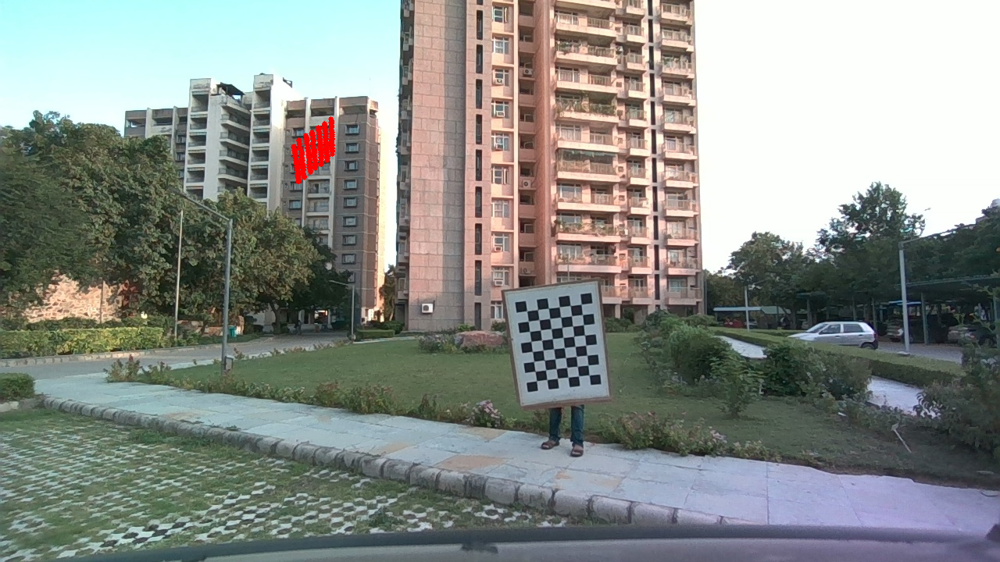

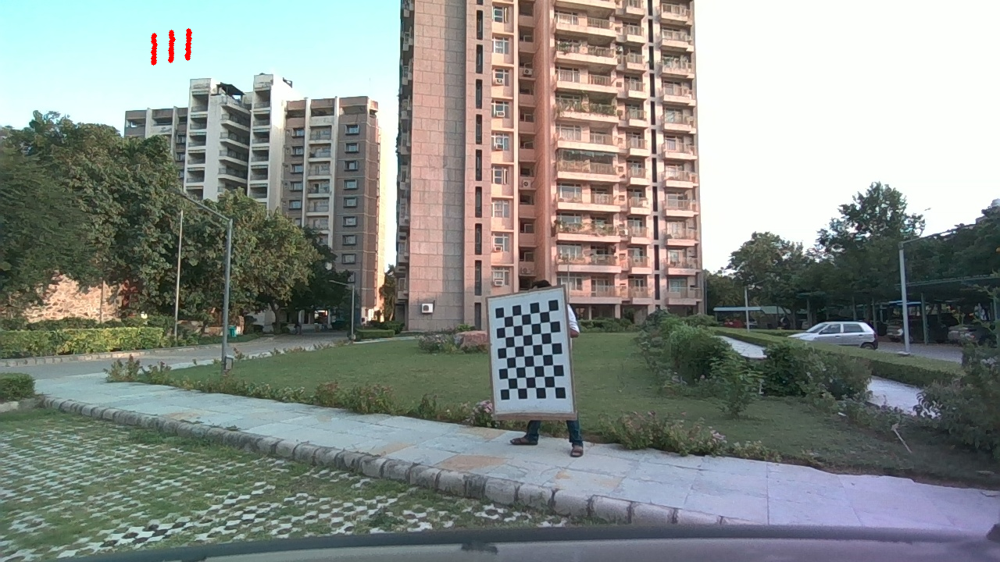

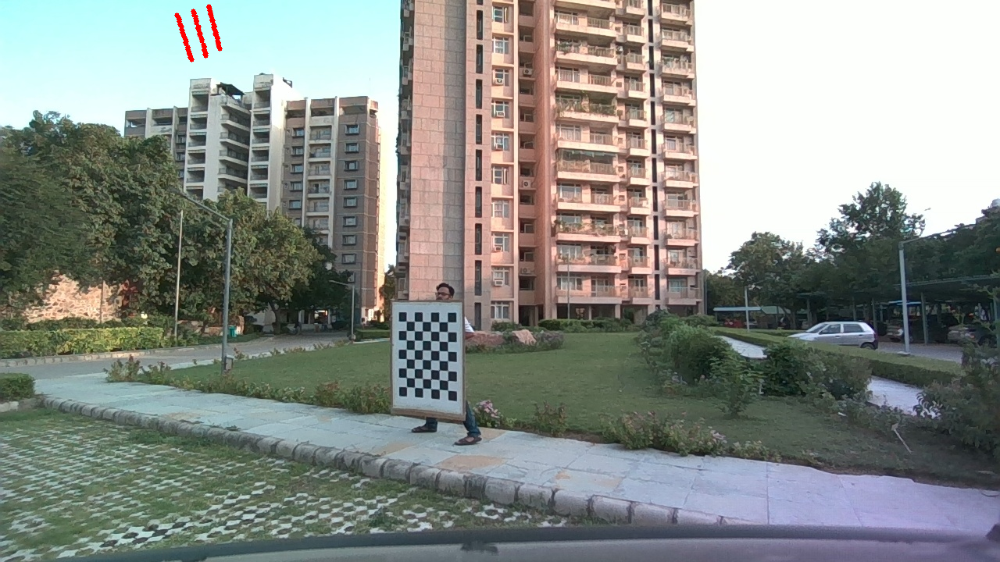

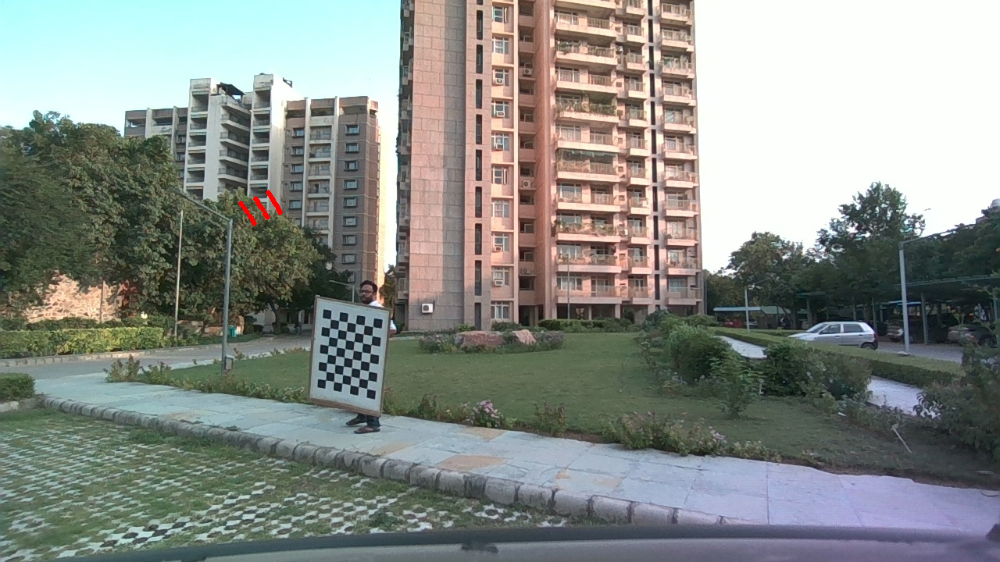

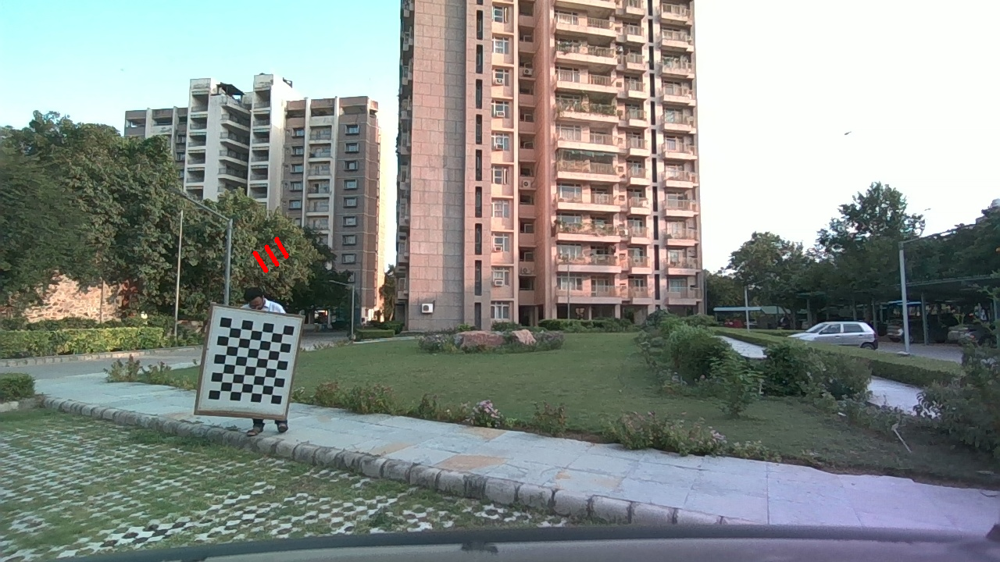

...

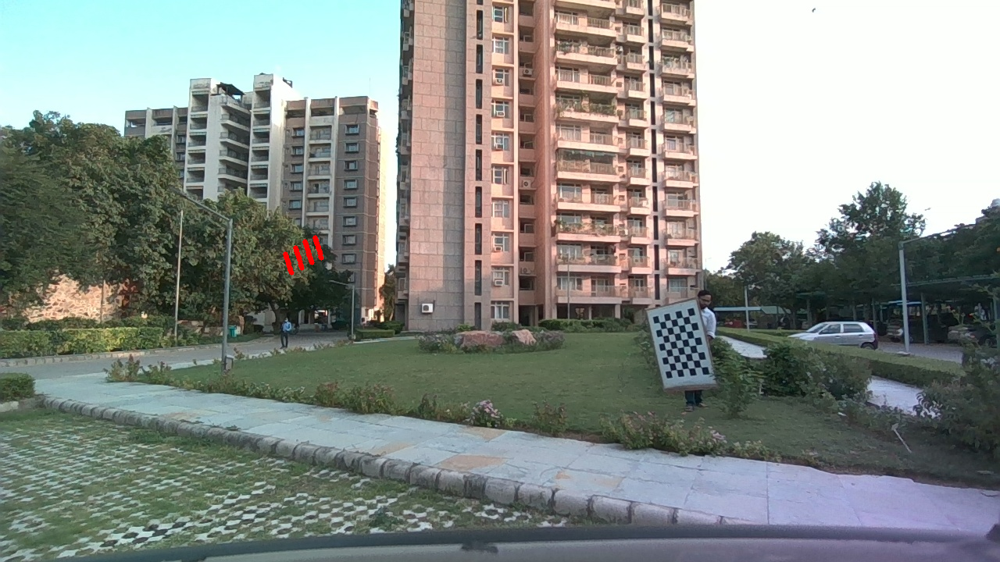

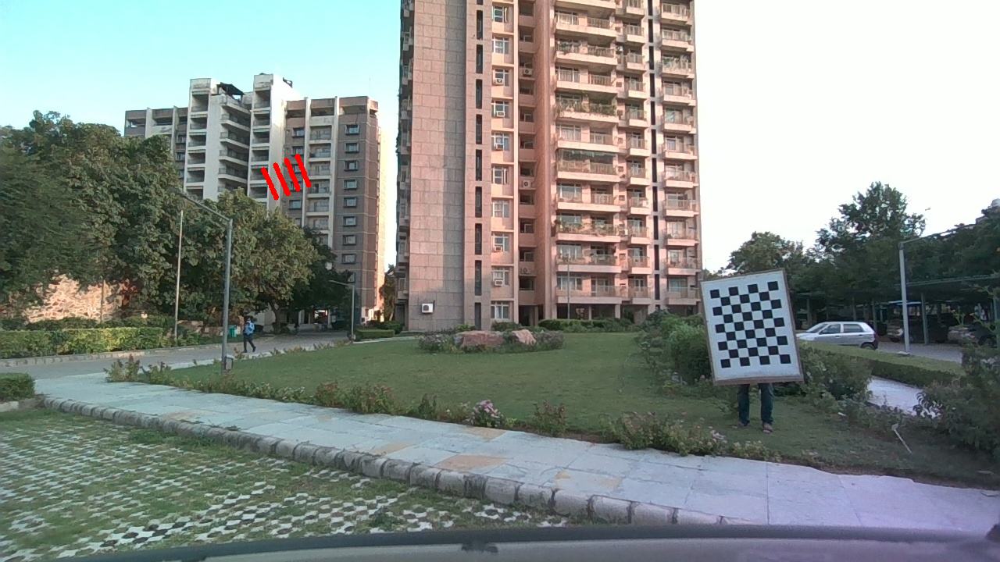

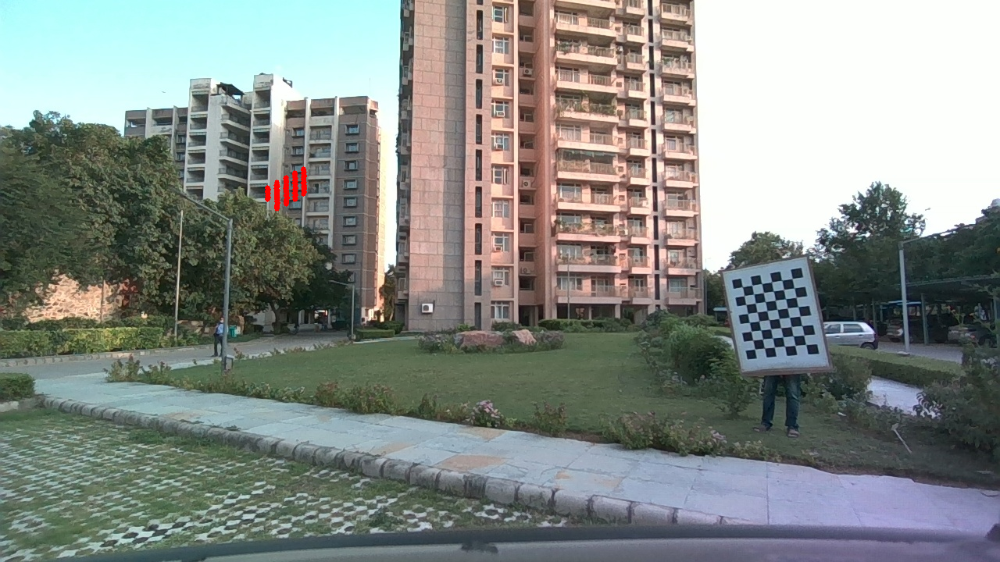

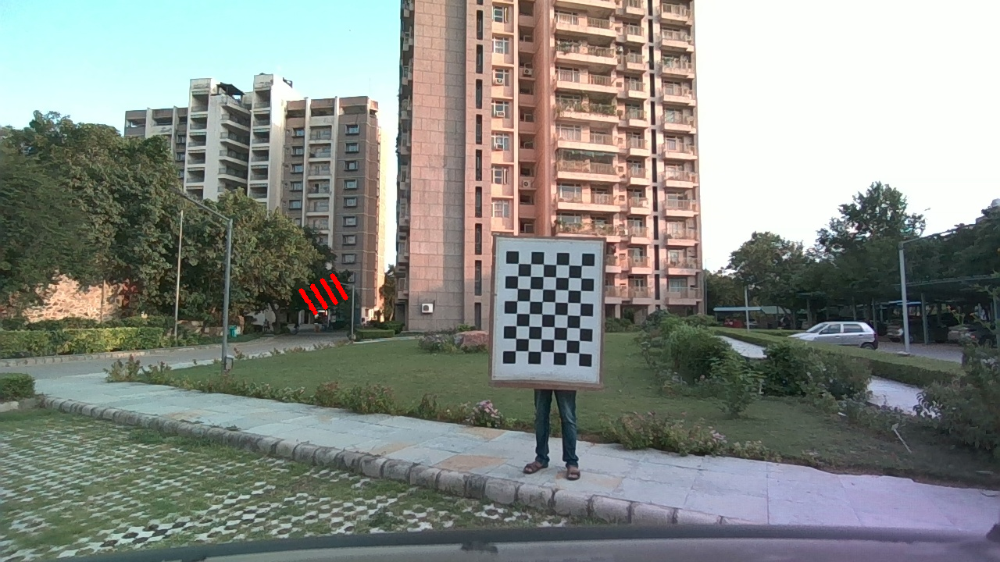

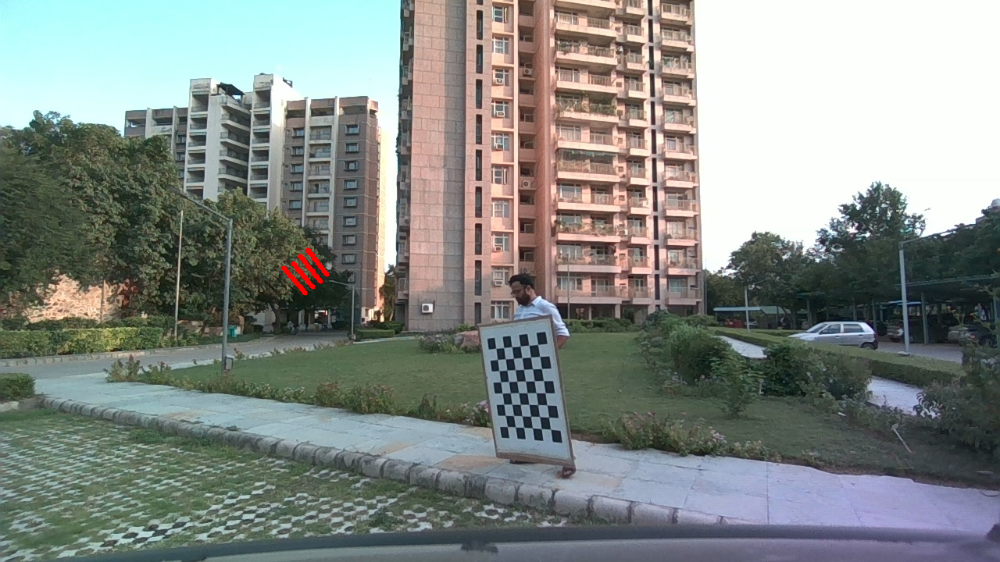

In [129]:
for i in range(25):

    curr_lidar_point = lidar_points[i] 
    curr_img = images[i] 
    
    image_points, _ = cv2.projectPoints( curr_lidar_point, cRl, ctl, K, dist)
    image = cv2.imread(curr_img) 
    
    for point in image_points:
        x, y = point.ravel()
        # print(point)
        xy_coord = (int(x), int(y))
        col = (0, 0, 255)
        cv2.circle(image, xy_coord , 3, col, -1)

    cv2_imshow( image)

    # cv2.imwrite('.\lcp\\'+ images[i][-15:-5]+'.JPG', image) 
    cv2.waitKey(0)
    cv2.destroyAllWindows()

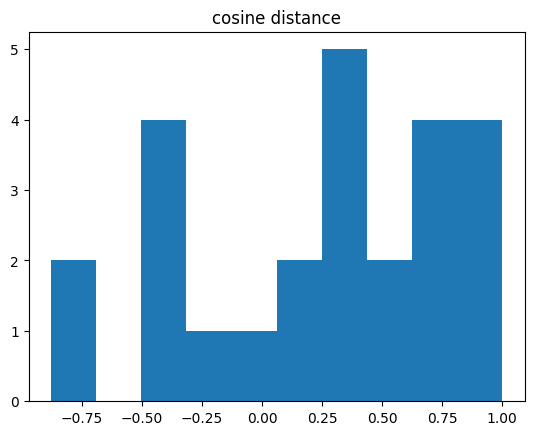

In [125]:
import matplotlib.pyplot as plt
cosinedist = []

for i in range(25):
    # t_nli = cRl@lidar_normal_offset[0][i]
    
    dot_product = np.dot(camera_normal_offset[0][i],cRl@lidar_normal_offset[0][i])
    
    a = np.linalg.norm(camera_normal_offset[0][i])

    b = np.linalg.norm(cRl@lidar_normal_offset[0][i])
    
    dot_product/=(a*b) 
    cosinedist.append(dot_product)

plt.hist(cosinedist)
plt.title("cosine distance")
plt.savefig('.\plots\histogram.png')
plt.show()

In [126]:
print("average error ", np.mean(cosinedist))
print(" standard deviation", np.std(cosinedist))

average error  0.2696878579001874
 standard deviation 0.5497982427658992


.\plots\frame_1093.png
.\plots\frame_1139.png
.\plots\frame_1153.png
.\plots\frame_1163.png
.\plots\frame_1195.png


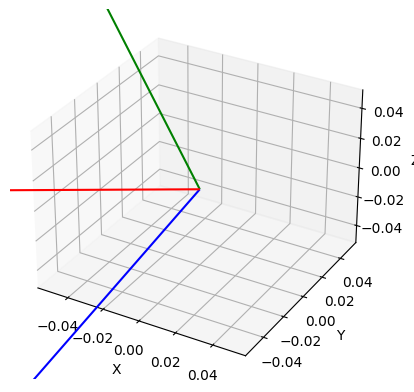

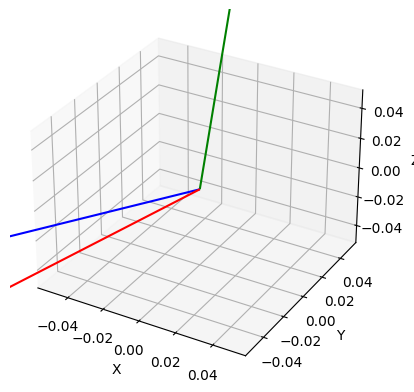

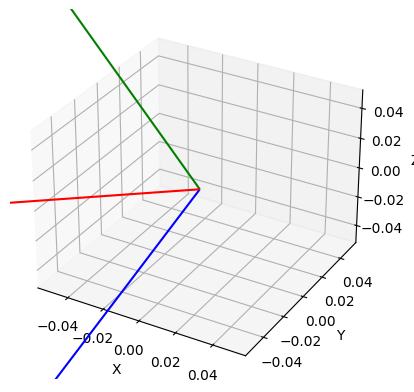

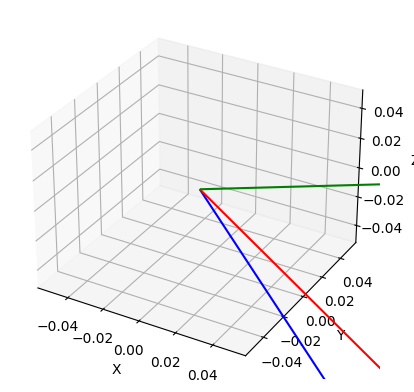

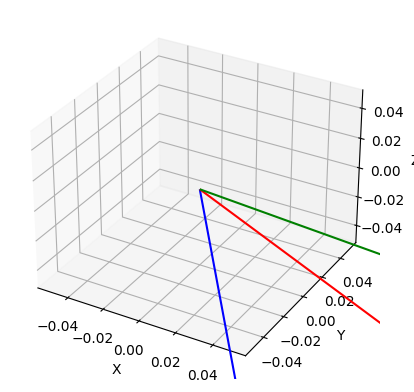

In [127]:
from mpl_toolkits.mplot3d import Axes3D

for i in range(5):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.set_zlabel('Z')
    
    ax.quiver(0, 0, 0, lidar_normal_offset[0][i][0], lidar_normal_offset[0][i][1], lidar_normal_offset[0][i][2], color='r')
    ax.quiver(0, 0, 0, camera_normal_offset[0][i][0], camera_normal_offset[0][i][1], camera_normal_offset[0][i][2], color='b')
    
    t_nli = cRl@lidar_normal_offset[0][i]
    ax.quiver(0, 0, 0, t_nli[0], t_nli[1], t_nli[2], color='r')
    # print('.\plots\\'+images[i][-15:-5]+'.png')
    plt.savefig('.\plots\\'+images[i][-15:-5]+'.png')

